Goal: Visualize Performance Spectrum of Each Log to roughly identify segment patterns

In [1]:
#import libaries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from matplotlib import colors as mcolors
from pandas.plotting import parallel_coordinates
import seaborn as sns
import os
import datetime as dt
import pm4py
# Log Conversion (pandas to log and vice versa)
from pm4py.objects.log.importer.xes import importer as xes_importer
from pm4py.objects.conversion.log import factory as log_conv
from pm4py.util import constants
from pm4py.util.business_hours import BusinessHours
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.objects.conversion.log import converter as log_conversion
from pm4py.objects.log.util import interval_lifecycle
# for prediction task
from datetime import datetime
from xgboost import XGBClassifier
import lightgbm as lgb
from sklearn import metrics
from sklearn.preprocessing import MinMaxScaler

In [2]:
import warnings
warnings.filterwarnings('ignore')

# Load Dataset

In [2]:
def preprocess_df(df):
    """
    Preprocessing function that parses the timestamps and resource information.
    :df: DataFrame that should be processed
    :returns: Preprocessed DataFrame
    """
    # Convert start timestamp
    df["Start Timestamp"] = pd.to_datetime(df['Start Timestamp'],utc=True).dt.tz_convert(None)
    # Convert end timestamp
    if("Complete Timestamp" in df.columns):
        df['Complete Timestamp'] = pd.to_datetime(df['Complete Timestamp'], utc=True).dt.tz_convert(None)
    # if resource is an int convert to string
    if (("Complete Timestamp" in df.columns) and (df["Resource"].dtype in ['int64', 'float64'])):
        df["Resource"] = df["Resource"].astype('str')
    return df

In [3]:
#fill missing values ( taken from https://github.com/PyRicky/LSTM_Generic_explainable/blob/master/load_dataset.py )
def fill_missing_end_dates(df, start_date_position, end_date_position):
    df[df.columns[end_date_position]] = df.apply(lambda row: row[start_date_position]
                  if row[end_date_position] == 0 else row[end_date_position], axis=1)
    return df

In [4]:
def sort_df(df):
    df.sort_values(["Case ID","Start Timestamp"], axis=0, ascending=True, inplace=True, kind='quicksort', na_position='last')
    return df

In [5]:
def load_event_log(filename):
    df = pd.read_csv(filename)
    df = preprocess_df(df)
    df = sort_df(df)
    return df

In [13]:
filename = 'prepared_data/traffic_fines.csv'
df = load_event_log(filename)
df = df.fillna(method='ffill')
df.head()

,amount,Resource,dismissal,Activity,vehicleClass,totalPaymentAmount,lifecycle:transition,Start Timestamp,article,points,Case ID,expense,notificationType,lastSent,paymentAmount,matricola
0,35.0,561.0,NIL,Create Fine,A,0.0,complete,2006-07-23 22:00:00,157.0,0.0,A1,NaN,NaN,NaN,NaN,NaN
1,35.0,561.0,NIL,Send Fine,A,0.0,complete,2006-12-04 23:00:00,157.0,0.0,A1,11.0,NaN,NaN,NaN,NaN
2,35.0,561.0,NIL,Create Fine,A,0.0,complete,2006-08-01 22:00:00,157.0,0.0,A100,11.0,NaN,NaN,NaN,NaN
3,35.0,561.0,NIL,Send Fine,A,0.0,complete,2006-12-11 23:00:00,157.0,0.0,A100,11.0,NaN,NaN,NaN,NaN
4,35.0,561.0,NIL,Insert Fine Notification,A,0.0,complete,2007-01-14 23:00:00,157.0,0.0,A100,11.0,P,P,NaN,NaN


# Visualize Performance Spectrum

In [14]:
#convert to log

In [6]:
 param_keys={constants.PARAMETER_CONSTANT_CASEID_KEY: 'Case ID',
        constants.PARAMETER_CONSTANT_RESOURCE_KEY: 'Resource', 
        constants.PARAMETER_CONSTANT_ACTIVITY_KEY: 'Activity',
        constants.PARAMETER_CONSTANT_START_TIMESTAMP_KEY: 'Start Timestamp',
        constants.PARAMETER_CONSTANT_TIMESTAMP_KEY: 'Complete Timestamp'}
def convert_df_to_log(df):
    #convert to log
    # Mapping between dataset columns and PM4Py keys
    # Many functions will require you to pass this as additional parameters
    log = log_conv.apply(df, parameters=param_keys)
    return log 

In [7]:
# function to return directly follow activities and frequency as a list as well as plot the distribution of frequencies
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery
def return_dfg_activities(log):
    dfg = dfg_discovery.apply(log, parameters=param_keys)
    plt.hist(x=dfg.values(),bins=50)
    plt.title("Distribution of Directly Follow Activities Frequencies")
    plt.show()
    threshold = 15
    return dfg,threshold

In [8]:
def check_if_dfg_in_activities(activities,dfg_activities):
    if dfg_activities[0] in activities:
        if dfg_activities[1] in activities:
            return True
        else:
            return False
    else:
        return False 

In [9]:
def get_cmap(n, name='hsv'):
    '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
    RGB color; the keyword argument name must be a standard mpl colormap name.'''
    return plt.cm.get_cmap(name, n)

In [65]:
# a = np.array([1,2,4,12])
# np.stack((a,a), axis=1)

In [64]:
# a = np.repeat(np.array([[5,3]], dtype=float),3,axis=0, )
# b = np.repeat(np.array([[1,0]]),3,axis=0)
# np.column_stack((a.flatten(),b.flatten()))
# np.stack((a,b), axis=-1)
# np.stack((a[:,0],b[:,0]), axis = -1)
# np.insert(a,2,np.nan, axis=1)

In [62]:
# x = np.arange(10)
# # Here are many sets of y to plot vs x
# ys = x[:5, np.newaxis] + x[np.newaxis, :]
# segs = np.zeros((5, 10, 2))
# segs[:, :, 1] = ys
# segs[:, :, 0] = x
# segs

In [10]:
def plot_performance_spectrum(data,a1,a2,axs,i,resource_key,segment, batch_delay, cmap, res_dict):
    cases = data.groupby("Case ID")["Activity"].apply(list).apply(lambda x: check_if_dfg_in_activities(x,[a1,a2])).reset_index(name="dfg_present")
    valid_cases = cases[cases["dfg_present"]==True]["Case ID"].unique()
    filter_df1 = data[(data["Activity"]== a1) & (data["Case ID"].isin(valid_cases))]
    filter_df2 = data[(data["Activity"]== a2) & (data["Case ID"].isin(valid_cases))]
    
    #add resources
    filter_df1.sort_values(["Case ID","Start Timestamp"], axis=0, ascending=True, inplace=True, kind='quicksort', na_position='last')
    resource_df = filter_df1.groupby(["Case ID"])[resource_key].first().reset_index(name="resources")
    
    filter_df1 = filter_df1.groupby(["Case ID"])["Start Timestamp"].min().reset_index(name="ta")
    filter_df2 = filter_df2.groupby(["Case ID"])["Start Timestamp"].min().reset_index(name="tb")
    filter_df = filter_df1.set_index("Case ID").join(filter_df2.set_index("Case ID"))
    filter_df = filter_df[filter_df["ta"]<=filter_df["tb"]]
    
    # get a datetime that is equal to epoch
    epoch = dt.datetime(1970, 1, 1)
    filter_df["ta"] = (pd.to_datetime(filter_df["ta"])- epoch).dt.total_seconds()
    filter_df["tb"] = (pd.to_datetime(filter_df["tb"])- epoch).dt.total_seconds()
    
    if(not filter_df.empty):
        times = filter_df.values
        x_values = np.array(sorted(times, key = lambda x: (x[0],x[1])))
        n = filter_df.shape[0]
        y_values = np.repeat(np.array([[1,0]], dtype=float),n,axis=0)
#         activity_a = np.insert(x_values,2,np.datetime64('NaT'), axis=1)
#         activity_b = np.insert(y_values,2,np.nan, axis=1)
#         activity_resources = np.insert(resources,2,np.nan, axis=1)
#         data_seg = pd.DataFrame({"x_values":activity_a.flatten(), "y_values":activity_b.flatten(), "resource": activity_resources.flatten()})
        axs[i].set_title(a1+":"+a2)
        
        # Mask some values to test masked array support:
        x = np.array(x_values, dtype= 'int64')
        ys = np.array(y_values, dtype = 'int64')
        segs = np.stack((x,ys),axis=-1)

        # We need to set the plot limits.
        axs[i].set_xlim(x.min(), x.max())
        axs[i].set_ylim(ys.min(), ys.max())

#         colors is sequence of rgba tuples
#         linestyle is a string or dash tuple. Legal string values are
#                  solid|dashed|dashdot|dotted.  The dash tuple is (offset, onoffseq)
#                  where onoffseq is an even length tuple of on and off ink in points.
#                  If linestyle is omitted, 'solid' is used
#         See :class:`matplotlib.collections.LineCollection` for more information

        # create case res mapping
        keys = list(resource_df["Case ID"].values)
        vals = list(resource_df["resources"].values)
        case_dict = dict()
        for k,v in zip(keys,vals):
            case_dict[k] = v
        res_list = list(map(lambda x: case_dict.get(x), filter_df.index.values))
#         colors = [mcolors.to_rgba(c)
#                   for c in plt.rcParams['axes.prop_cycle'].by_key()['color']]
        colors = [cmap(res_dict.get(r)) for r in res_list]

        line_segments = LineCollection(segs, linewidths=(0.5, 1, 1.5, 2),
                                       colors=colors, linestyle='solid')
        axs[i].add_collection(line_segments)
        return filter_df
#         plt.show()
#         return segment_data
    else:
        return filter_df

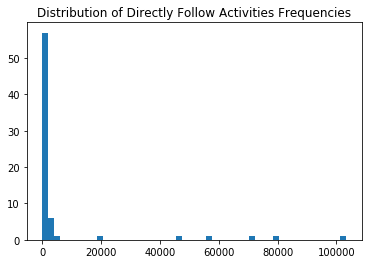

[('Create Fine', 'Send Fine'),
 ('Send Fine', 'Insert Fine Notification'),
 ('Insert Fine Notification', 'Add penalty'),
 ('Add penalty', 'Send for Credit Collection'),
 ('Add penalty', 'Payment'),
 ('Insert Fine Notification', 'Insert Date Appeal to Prefecture'),
 ('Insert Date Appeal to Prefecture', 'Add penalty'),
 ('Add penalty', 'Send Appeal to Prefecture'),
 ('Create Fine', 'Payment'),
 ('Payment', 'Payment'),
 ('Add penalty', 'Insert Date Appeal to Prefecture'),
 ('Insert Date Appeal to Prefecture', 'Send Appeal to Prefecture'),
 ('Insert Date Appeal to Prefecture', 'Payment'),
 ('Payment', 'Add penalty'),
 ('Payment', 'Send for Credit Collection'),
 ('Send Appeal to Prefecture', 'Receive Result Appeal from Prefecture'),
 ('Receive Result Appeal from Prefecture', 'Notify Result Appeal to Offender'),
 ('Notify Result Appeal to Offender', 'Payment'),
 ('Send Fine', 'Payment'),
 ('Insert Fine Notification', 'Payment'),
 ('Payment', 'Send Fine'),
 ('Notify Result Appeal to Offender'

In [20]:
# filter dfg activities for important segments using thresholds
log = convert_df_to_log(df)
dfg,threshold = return_dfg_activities(log)
dfg_activities_unique = list(dfg.keys())
#dfg_activities_unique = list(filter(lambda x:(x[0]!=x[1]) and (dfg.get(x)>16),dfg_activities))
segment_dict = dict()
i=1
for val in dfg_activities_unique:
    segment_dict[val]=i
    i=i+1
dfg_activities_unique

In [23]:
plt.rcParams['agg.path.chunksize'] = 10000

In [22]:
n = len(dfg_activities_unique[:10])
fig, axs = plt.subplots(n,figsize=(50*n,30*n), sharex=True)
plt.subplots_adjust(hspace = 0.5)
#axs="plt"
i = 0
df_list = []

# create color categories by resource
resources = df["Resource"].unique()
res_dict = dict()
for x,y in enumerate(resources):
    res_dict[y]= x
cmap = get_cmap(len(res_dict))

for a1,a2 in dfg_activities_unique[:10]:
    #print(a1,a2)
    segment= segment_dict.get((a1,a2)) 
    #print(segment)
    df_list.append(plot_performance_spectrum(df,a1,a2,axs,i,"Resource",segment,'30S', cmap, res_dict))
    i=i+1
fig.tight_layout()
plt.savefig("performance_spectrum_results/traffic_fines.pdf")

ValueError: Image size of 252000x151200 pixels is too large. It must be less than 2^16 in each direction.

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x0000016BAA71E950> (for post_execute):


ValueError: Image size of 252000x151200 pixels is too large. It must be less than 2^16 in each direction.

ValueError: Image size of 252000x151200 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 252000x151200 with 70 Axes>

In [55]:
# Basic Process Model

# Production Log 

In [24]:
filename = 'prepared_data/Production_Data.csv'
df = load_event_log(filename)
df = df.fillna(method='ffill')
df.head()

,Case ID,Activity,Resource,Start Timestamp,Complete Timestamp,Span,Work Order Qty,Part Desc.,Worker ID,Report Type,Qty Completed,Qty Rejected,Qty for MRB,Rework
0,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-29 23:24:00,2012-01-30 05:43:00,006:19,10,Cable Head,ID4932,S,1,0,0,NaN
1,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-30 05:44:00,2012-01-30 06:42:00,000:58,10,Cable Head,ID4932,D,1,0,0,NaN
2,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-30 06:59:00,2012-01-30 07:21:00,000:22,10,Cable Head,ID4167,S,0,0,0,NaN
3,Case 1,Turning & Milling - Machine 4,Machine 4 - Turning & Milling,2012-01-30 07:21:00,2012-01-30 10:58:00,003:37,10,Cable Head,ID4167,D,8,0,0,NaN
4,Case 1,Turning & Milling Q.C.,Quality Check 1,2012-01-31 13:20:00,2012-01-31 14:50:00,001:30,10,Cable Head,ID4163,D,9,1,0,NaN


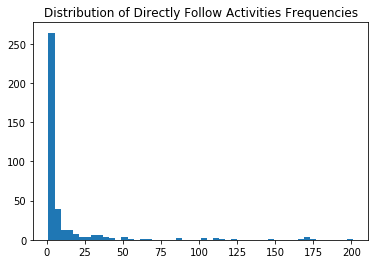

[('Turning & Milling - Machine 4', 'Turning & Milling Q.C.'),
 ('Turning & Milling Q.C.', 'Laser Marking - Machine 7'),
 ('Laser Marking - Machine 7', 'Lapping - Machine 1'),
 ('Lapping - Machine 1', 'Round Grinding - Machine 3'),
 ('Round Grinding - Machine 3', 'Final Inspection Q.C.'),
 ('Final Inspection Q.C.', 'Packing'),
 ('Turning Q.C.', 'Laser Marking - Machine 7'),
 ('Laser Marking - Machine 7', 'Flat Grinding - Machine 11'),
 ('Turning & Milling - Machine 8', 'Turning & Milling Q.C.'),
 ('Flat Grinding - Machine 11', 'Lapping - Machine 1'),
 ('Packing', 'Final Inspection Q.C.'),
 ('Turning & Milling Q.C.', 'Flat Grinding - Machine 11'),
 ('Lapping - Machine 1', 'Round Grinding - Machine 12'),
 ('Round Grinding - Machine 12', 'Final Inspection Q.C.'),
 ('Final Inspection Q.C.', 'Lapping - Machine 1'),
 ('Lapping - Machine 1', 'Laser Marking - Machine 7'),
 ('Laser Marking - Machine 7', 'Packing'),
 ('Turning & Milling Q.C.', 'Turning & Milling - Machine 8'),
 ('Lapping - Machin

In [28]:
# filter dfg activities for important segments using thresholds
log = convert_df_to_log(df)
dfg,threshold = return_dfg_activities(log)
dfg_activities_unique = list(dfg.keys())
dfg_activities_unique = list(filter(lambda x:(x[0]!=x[1]) and (dfg.get(x)>10),dfg_activities_unique))
segment_dict = dict()
i=1
for val in dfg_activities_unique:
    segment_dict[val]=i
    i=i+1
dfg_activities_unique

In [31]:
n = len(dfg_activities_unique[:10])
fig, axs = plt.subplots(n,figsize=(50*n,30*n), sharex=True)
plt.subplots_adjust(hspace = 0.5)
#axs="plt"
i = 0
df_list = []

# create color categories by resource
resources = df["Resource"].unique()
res_dict = dict()
for x,y in enumerate(resources):
    res_dict[y]= x
cmap = get_cmap(len(res_dict))

for a1,a2 in dfg_activities_unique[:10]:
    #print(a1,a2)
    segment= segment_dict.get((a1,a2)) 
    #print(segment)
    df_list.append(plot_performance_spectrum(df,a1,a2,axs,i,"Resource",segment,'30S', cmap, res_dict))
    i=i+1
#plt.tight_layout()
plt.savefig("performance_spectrum_results/performance_spectrum_production.pdf")

# bpi Logs 

In [32]:
filename = 'prepared_data/bpi12a'
df = load_event_log(filename)
df = df.fillna(method='ffill')
df.head()

,Case ID,Activity,Complete Timestamp,AMOUNT_REQ,Start Timestamp,Resource
0,173688,A_SUBMITTED,2011-10-01 00:38:00,20000,2011-10-01 00:38:00,112
1,173688,A_PARTLYSUBMITTED,2011-10-01 00:38:00,20000,2011-10-01 00:38:00,112
2,173688,A_PREACCEPTED,2011-10-01 00:39:00,20000,2011-10-01 00:38:00,112
3,173688,A_PREACCEPTED,2011-10-01 00:39:00,20000,2011-10-01 00:38:00,112
4,173688,A_ACCEPTED,2011-10-01 11:42:00,20000,2011-10-01 00:38:00,10862


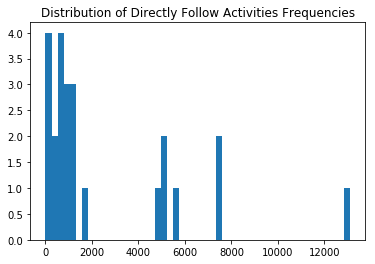

[('A_SUBMITTED', 'A_PARTLYSUBMITTED'),
 ('A_PARTLYSUBMITTED', 'A_PREACCEPTED'),
 ('A_PREACCEPTED', 'A_PREACCEPTED'),
 ('A_PREACCEPTED', 'A_ACCEPTED'),
 ('A_ACCEPTED', 'A_FINALIZED'),
 ('A_FINALIZED', 'A_REGISTERED'),
 ('A_REGISTERED', 'A_APPROVED'),
 ('A_APPROVED', 'A_ACTIVATED'),
 ('A_FINALIZED', 'A_APPROVED'),
 ('A_APPROVED', 'A_REGISTERED'),
 ('A_REGISTERED', 'A_ACTIVATED'),
 ('A_ACTIVATED', 'A_ACTIVATED'),
 ('A_PARTLYSUBMITTED', 'A_DECLINED'),
 ('A_PREACCEPTED', 'A_CANCELLED'),
 ('A_PARTLYSUBMITTED', 'A_PARTLYSUBMITTED'),
 ('A_PREACCEPTED', 'A_DECLINED'),
 ('A_FINALIZED', 'A_DECLINED'),
 ('A_FINALIZED', 'A_ACTIVATED'),
 ('A_ACTIVATED', 'A_REGISTERED'),
 ('A_FINALIZED', 'A_CANCELLED'),
 ('A_ACTIVATED', 'A_APPROVED'),
 ('A_ACCEPTED', 'A_DECLINED'),
 ('A_ACCEPTED', 'A_CANCELLED'),
 ('A_PARTLYSUBMITTED', 'A_CANCELLED')]

In [33]:
# filter dfg activities for important segments using thresholds
log = convert_df_to_log(df)
dfg,threshold = return_dfg_activities(log)
dfg_activities_unique = list(dfg.keys())
#dfg_activities_unique = list(filter(lambda x:(x[0]!=x[1]) and (dfg.get(x)>16),dfg_activities))
segment_dict = dict()
i=1
for val in dfg_activities_unique:
    segment_dict[val]=i
    i=i+1
dfg_activities_unique

In [40]:
n = len(dfg_activities_unique[:10])
fig, axs = plt.subplots(n,figsize=(60*n,20*n), sharex=True)
plt.subplots_adjust(left=0.3, right=0.9, bottom=0.3, top=1.0)
#axs="plt"
i = 0
df_list = []

# create color categories by resource
resources = df["Resource"].unique()
res_dict = dict()
for x,y in enumerate(resources):
    res_dict[y]= x
cmap = get_cmap(len(res_dict))

for a1,a2 in dfg_activities_unique[:10]:
    #print(a1,a2)
    segment= segment_dict.get((a1,a2)) 
    #print(segment)
    df_list.append(plot_performance_spectrum(df,a1,a2,axs,i,"Resource",segment,'30S', cmap, res_dict))
    i=i+1    
plt.savefig("performance_spectrum_results/performance_spectrum_bpi12a.pdf", bbox_inches = "tight")

# BPI20 Log

In [11]:
filename = 'prepared_data/bpi20.csv'
df = load_event_log(filename)
df = df.fillna(method='ffill')
df.head()

,id,Resource,Activity,Start Timestamp,org:role,case:id,Case ID,case:BudgetNumber,case:DeclarationNumber,case:Amount
12788,st_step 100004_0,STAFF MEMBER,Declaration SUBMITTED by EMPLOYEE,2018-01-30 08:20:07,EMPLOYEE,declaration 100000,declaration 100000,budget 86566,declaration number 100001,600.844121
12789,st_step 100003_0,STAFF MEMBER,Declaration APPROVED by ADMINISTRATION,2018-02-07 08:58:46,ADMINISTRATION,declaration 100000,declaration 100000,budget 86566,declaration number 100001,600.844121
12790,st_step 100002_0,STAFF MEMBER,Declaration FINAL_APPROVED by SUPERVISOR,2018-02-08 09:59:05,SUPERVISOR,declaration 100000,declaration 100000,budget 86566,declaration number 100001,600.844121
12791,dd_declaration 100000_19,SYSTEM,Request Payment,2018-02-09 11:42:49,UNDEFINED,declaration 100000,declaration 100000,budget 86566,declaration number 100001,600.844121
12792,dd_declaration 100000_20,SYSTEM,Payment Handled,2018-02-12 16:31:20,UNDEFINED,declaration 100000,declaration 100000,budget 86566,declaration number 100001,600.844121


C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: DeprecatedWarning: apply is deprecated as of 1.3.0 and will be removed in 2.0.0. Use algorithm entrypoint instead
  # Remove the CWD from sys.path while we load stuff.


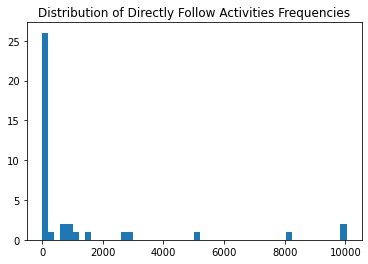

[('Declaration SUBMITTED by EMPLOYEE',
  'Declaration APPROVED by ADMINISTRATION'),
 ('Declaration APPROVED by ADMINISTRATION',
  'Declaration FINAL_APPROVED by SUPERVISOR'),
 ('Declaration FINAL_APPROVED by SUPERVISOR', 'Request Payment'),
 ('Request Payment', 'Payment Handled'),
 ('Declaration APPROVED by ADMINISTRATION',
  'Declaration APPROVED by BUDGET OWNER'),
 ('Declaration APPROVED by BUDGET OWNER',
  'Declaration FINAL_APPROVED by SUPERVISOR'),
 ('Declaration SUBMITTED by EMPLOYEE',
  'Declaration REJECTED by ADMINISTRATION'),
 ('Declaration REJECTED by ADMINISTRATION',
  'Declaration REJECTED by EMPLOYEE'),
 ('Declaration REJECTED by EMPLOYEE', 'Declaration SUBMITTED by EMPLOYEE'),
 ('Declaration SUBMITTED by EMPLOYEE', 'Declaration APPROVED by PRE_APPROVER'),
 ('Declaration APPROVED by PRE_APPROVER',
  'Declaration FINAL_APPROVED by SUPERVISOR'),
 ('Declaration FINAL_APPROVED by SUPERVISOR',
  'Declaration REJECTED by MISSING'),
 ('Declaration REJECTED by MISSING', 'Declarat

In [12]:
# filter dfg activities for important segments using thresholds
log = convert_df_to_log(df)
dfg,threshold = return_dfg_activities(log)
dfg_activities_unique = list(dfg.keys())
#dfg_activities_unique = list(filter(lambda x:(x[0]!=x[1]) and (dfg.get(x)>16),dfg_activities))
segment_dict = dict()
i=1
for val in dfg_activities_unique:
    segment_dict[val]=i
    i=i+1
dfg_activities_unique

In [13]:
n = len(dfg_activities_unique[:10])
fig, axs = plt.subplots(n,figsize=(60*n,20*n), sharex=True)
plt.subplots_adjust(left=0.3, right=0.9, bottom=0.3, top=1.0)
#axs="plt"
i = 0
df_list = []

# create color categories by resource
resources = df["Resource"].unique()
res_dict = dict()
for x,y in enumerate(resources):
    res_dict[y]= x
cmap = get_cmap(len(res_dict))

for a1,a2 in dfg_activities_unique[:10]:
    #print(a1,a2)
    segment= segment_dict.get((a1,a2)) 
    #print(segment)
    df_list.append(plot_performance_spectrum(df,a1,a2,axs,i,"Resource",segment,'30S', cmap, res_dict))
    i=i+1    
plt.savefig("performance_spectrum_results/performance_spectrum_bpi20.pdf", bbox_inches = "tight")

C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: Settin

In [15]:
n = len(dfg_activities_unique[10:15])
fig, axs = plt.subplots(n,figsize=(60*n,20*n), sharex=True)
plt.subplots_adjust(left=0.3, right=0.9, bottom=0.3, top=1.0)
#axs="plt"
i = 0
df_list = []

# create color categories by resource
resources = df["Resource"].unique()
res_dict = dict()
for x,y in enumerate(resources):
    res_dict[y]= x
cmap = get_cmap(len(res_dict))

for a1,a2 in dfg_activities_unique[10:15]:
    #print(a1,a2)
    segment= segment_dict.get((a1,a2)) 
    #print(segment)
    df_list.append(plot_performance_spectrum(df,a1,a2,axs,i,"Resource",segment,'30S', cmap, res_dict))
    i=i+1    
plt.savefig("performance_spectrum_results/performance_spectrum_bpi20_2.pdf", bbox_inches = "tight")

C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Shreya Kar\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: Settin